In [1]:
from sklearn import preprocessing
import pandas as pd
import numpy as np
from sklearn import tree
import matplotlib.pyplot as plt
from datetime import datetime
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy import stats


df_per= pd.read_excel("C:/Users/57314/Documents/LEONARDO/CAR/CAR 2023/CIENCIA DE DATOS DLIA/DATOS RAMCA/Periodo 1 B. peristaltica.xlsx")
df_dia= pd.read_excel("C:/Users/57314/Documents/LEONARDO/CAR/CAR 2023/CIENCIA DE DATOS DLIA/DATOS RAMCA/Periodo 2. B diafragma.xlsx")


## Bomba peristaltica

In [72]:
len(df_per)

6623

In [73]:
df_per

,DateTime,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C
0,2023-04-01 00:00:00,7.18,407.24,0.02,60.91,203.60,18.52,30.82,62.33,209.36,231.76,16.79
1,2023-04-01 00:05:00,7.18,409.09,0.02,60.91,202.01,18.57,30.90,62.82,210.93,231.35,16.79
2,2023-04-01 00:10:00,7.18,406.30,0.02,60.98,195.81,18.56,31.06,61.50,211.58,231.73,16.79
3,2023-04-01 00:15:00,7.18,407.02,0.03,61.03,196.10,18.59,31.11,62.27,210.63,234.00,16.83
4,2023-04-01 00:20:00,7.18,407.50,0.03,59.56,189.76,18.57,31.17,60.86,210.52,231.31,16.86
...,...,...,...,...,...,...,...,...,...,...,...,...
6618,2023-04-27 23:35:00,7.13,428.59,0.03,91.46,142.42,19.29,35.65,71.02,0.00,217.88,16.75
6619,2023-04-27 23:40:00,7.13,432.81,0.03,91.46,144.14,19.20,35.59,73.61,13831.00,218.72,16.74
6620,2023-04-27 23:45:00,7.13,431.19,0.03,90.96,145.33,19.20,35.59,75.81,8855.59,218.68,16.75
6621,2023-04-27 23:50:00,7.14,427.31,0.03,89.03,144.92,19.20,35.59,78.02,5822.36,218.75,16.74


In [74]:
df_per.describe()

,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C
count,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000
mean,7.238013,409.282547,0.307146,54.201173,180.597217,19.470846,35.414780,154.433763,203.098597,205.918129,18.969644
std,0.198663,77.907842,1.043050,70.671662,43.138461,5.967620,6.291105,130.766617,385.121090,29.734286,2.222191
min,0.000000,0.000000,0.000000,0.000000,90.800000,2.290000,3.160000,26.270000,0.000000,159.090000,0.000000
25%,7.160000,356.485000,0.020000,18.545000,154.715000,14.390000,31.510000,55.720000,76.935000,181.645000,17.390000
50%,7.240000,419.150000,0.030000,38.400000,170.980000,17.990000,35.380000,109.560000,153.410000,200.150000,18.570000
75%,7.350000,448.895000,0.030000,60.975000,187.300000,24.765000,39.760000,216.645000,205.740000,217.490000,20.520000
max,7.910000,1331.600000,7.130000,2842.860000,534.690000,65.710000,51.080000,674.490000,13831.000000,486.800000,25.080000


In [75]:
df_per.dtypes

DateTime         datetime64[ns]
pH_pH                   float64
X_uS/cm                 float64
O2_mg/l                 float64
TUR_NTU                 float64
NO3_mg/l                float64
NH4_mg/l                float64
K_mg/l                  float64
Cloruros_mg/L           float64
Solidos_mg/L            float64
Nivel_cm                float64
Temp_°C                 float64
dtype: object

In [76]:
# Contar Nulos
null_count = df_per.isnull().sum(axis=0)
# Imprimimos el resultado
print(null_count)

DateTime         0
pH_pH            0
X_uS/cm          0
O2_mg/l          0
TUR_NTU          0
NO3_mg/l         0
NH4_mg/l         0
K_mg/l           0
Cloruros_mg/L    0
Solidos_mg/L     0
Nivel_cm         0
Temp_°C          0
dtype: int64


<AxesSubplot:>

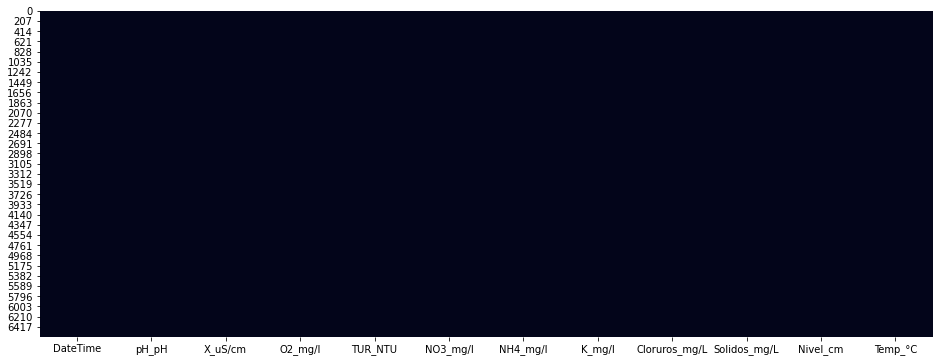

In [77]:
# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_per.isnull(), cbar=False)

In [78]:
df_per["Pluviometro [mm/min]"].value_counts(dropna=False).head(3)

KeyError: 'Pluviometro [mm/min]'

In [ ]:
df_per["Velocidad [m/s]"].value_counts(dropna=False).head(3)

In [ ]:
columnas_eliminar = ["Velocidad [m/s]", "Pluviometro [mm/min]"]
df_per = df_per.drop(columnas_eliminar, axis=1)

In [ ]:
# Eliminamos las filas con missing Values, se elimina todos los las filas NAN son las mismas en todas las columnas 
df_per.dropna(subset=['pH [pH]'], inplace=True)

In [ ]:
# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_per.isnull(), cbar=False)

In [ ]:
df_per.reset_index(drop=True, inplace=True)

In [ ]:
columns = list(df_per.columns)
columns = columns[1:]

In [79]:
columns_sin_espacios = list()
for i in range(0,len(columns)):
    columnSinEspacios = columns[i].replace(" ", "")
    columnSinEspacios = columnSinEspacios.replace("[", "_")
    columnSinEspacios = columnSinEspacios.replace("]", "")
    columns_sin_espacios.append(columnSinEspacios)

In [80]:
for i in range(0,len(columns)):
    df_per = df_per.rename(columns={columns[i]: columns_sin_espacios[i]})

# Cambiar los nombres para el manejo de variables 

In [81]:
columns = list(df_per.columns)
columns = columns[1:]
columns

['pH_pH',
 'X_uS/cm',
 'O2_mg/l',
 'TUR_NTU',
 'NO3_mg/l',
 'NH4_mg/l',
 'K_mg/l',
 'Cloruros_mg/L',
 'Solidos_mg/L',
 'Nivel_cm',
 'Temp_°C']

In [82]:
for column in columns:
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico en el primer subplot
    fig.add_trace(go.Box(y=df_per[column], name = "Violin"), row=1, col=1)

    # Agregar el segundo gráfico en el segundo subplot
    fig.add_trace(go.Histogram(x=df_per[column], nbinsx=100, name = "Histograma"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=950, height=400, title="Graficas de violin de "+ column +" para bomba peristaltica")

    # Mostrar la figura
    fig.show()


In [83]:
variables_z = list()
for column in columns:
    variable_name = "z_" + column
    globals()[variable_name] = np.abs(stats.zscore(df_per[column]))
    variables_z.append(variable_name)

In [84]:
variables_z

['z_pH_pH',
 'z_X_uS/cm',
 'z_O2_mg/l',
 'z_TUR_NTU',
 'z_NO3_mg/l',
 'z_NH4_mg/l',
 'z_K_mg/l',
 'z_Cloruros_mg/L',
 'z_Solidos_mg/L',
 'z_Nivel_cm',
 'z_Temp_°C']

In [85]:
z_pH_pH

array([0.29203907, 0.29203907, 0.29203907, ..., 0.54374055, 0.49340025,
       0.49340025])

In [86]:
variables_atipicos = list()
for i in range(0,len(columns)):
    variable_name = "atp_" + columns[i]
    globals()[variable_name] = (np.where(globals()[variables_z[i]] > 3))
    variables_atipicos.append(variable_name)
variables_atipicos

['atp_pH_pH',
 'atp_X_uS/cm',
 'atp_O2_mg/l',
 'atp_TUR_NTU',
 'atp_NO3_mg/l',
 'atp_NH4_mg/l',
 'atp_K_mg/l',
 'atp_Cloruros_mg/L',
 'atp_Solidos_mg/L',
 'atp_Nivel_cm',
 'atp_Temp_°C']

In [87]:
atp_pH_pH

(array([ 656,  657,  668,  669,  670,  671,  672,  673,  674,  675,  676,
         677,  678,  679,  680,  717,  718,  719,  720,  721,  722,  723,
         724,  725, 2702, 2703, 3837, 3838, 3839, 3840, 3841, 3842, 3843,
        3844, 3845, 4619, 4620], dtype=int64),)

In [90]:
dataframe_names = list()
# Crear los DataFrames y asignarles nombres de variables
for i in range(len(columns)):
    dataframe_name = f"df_sin_atp_{variables_atipicos[i]}"
    globals()[dataframe_name] = df_per[[columns[i],"DateTime"]].drop(index = globals()[variables_atipicos[i]][0])
    dataframe_names.append(dataframe_name)
dataframe_names

['df_sin_atp_atp_pH_pH',
 'df_sin_atp_atp_X_uS/cm',
 'df_sin_atp_atp_O2_mg/l',
 'df_sin_atp_atp_TUR_NTU',
 'df_sin_atp_atp_NO3_mg/l',
 'df_sin_atp_atp_NH4_mg/l',
 'df_sin_atp_atp_K_mg/l',
 'df_sin_atp_atp_Cloruros_mg/L',
 'df_sin_atp_atp_Solidos_mg/L',
 'df_sin_atp_atp_Nivel_cm',
 'df_sin_atp_atp_Temp_°C']

In [91]:
globals()[dataframe_names[1]]

,X_uS/cm,DateTime
0,407.24,2023-04-01 00:00:00
1,409.09,2023-04-01 00:05:00
2,406.30,2023-04-01 00:10:00
3,407.02,2023-04-01 00:15:00
4,407.50,2023-04-01 00:20:00
...,...,...
6618,428.59,2023-04-27 23:35:00
6619,432.81,2023-04-27 23:40:00
6620,431.19,2023-04-27 23:45:00
6621,427.31,2023-04-27 23:50:00


In [92]:
for i in range(len(columns)):
    globals()[dataframe_names[i]].reset_index(drop=True, inplace=True)

In [93]:
globals()[dataframe_names[1]].iloc[:, 0]

0       407.24
1       409.09
2       406.30
3       407.02
4       407.50
         ...  
6540    428.59
6541    432.81
6542    431.19
6543    427.31
6544    424.91
Name: X_uS/cm, Length: 6545, dtype: float64

# Comparacion diagrama de Bigotes - violin, con y sin datos atipicos

In [94]:
for i in range(len(columns)):
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico en el primer subplot
    fig.add_trace(go.Box(y=df_per[columns[i]], name = "sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico en el segundo subplot
    fig.add_trace(go.Box(y=globals()[dataframe_names[i]].iloc[:, 0], name = "con limpieza"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=1000, height=400, title="Graficas de bigotes de " + columns[i] +" para bomba peristaltica")

    # Mostrar la figura
    fig.show()

In [95]:
import plotly.io as pio
for i in range(len(columns)):
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico (violin plot) en el primer subplot
    fig.add_trace(go.Violin(y=df_per[columns[i]], name="sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico (violin plot) en el segundo subplot
    fig.add_trace(go.Violin(y=globals()[dataframe_names[i]].iloc[:, 0], name="con limpieza"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=1000, height=400, title="Gráficas de violín de " + columns[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    
    #Guardar HTML
    #file_name = "graficas_violin_" + columns[i] + ".html"
    #pio.write_html(fig, file_name)

El valor de "kde" en el contexto de los diagramas de violín se refiere a la estimación de densidad del kernel (Kernel Density Estimation, KDE por sus siglas en inglés). El KDE es una técnica utilizada para estimar la función de densidad de probabilidad de un conjunto de datos. En el caso de los diagramas de violín, el KDE se utiliza para trazar una curva suave que muestra la estimación de la distribución de los datos.

# Serie de tiempo para PH 

In [98]:
for i in range(len(columns)):
    # Crear la figura con subplots
    fig = make_subplots(rows=2, cols=1)

    # Agregar el primer gráfico de líneas en el primer subplot
    fig.add_trace(go.Line(x=df_per['DateTime'], y=df_per['pH_pH'], name = "Sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico de líneas en el segundo subplot
    fig.add_trace(go.Line(x=globals()[dataframe_names[i]].iloc[:, 1], y=globals()[dataframe_names[i]].iloc[:, 0], name = "Con limpieza"), row=2, col=1)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(height=500, width=1000, title_text="Gráficas de violín de " + columns[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    

# Medias moviles

In [99]:
# Calcular las medias móviles utilizando pandas
window_sizes = [50, 200,500]  # Tamaños de las ventanas de las medias móviles

for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    df_sin_at_ph[column_name] = df_sin_at_ph['pH_pH'].rolling(window=window_size).mean()

# Crear el gráfico de línea
fig = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_sin_at_ph['DateTime'], y=df_sin_at_ph['pH_pH'], name='Datos Originales'))

# Agregar las líneas de las medias móviles
for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    fig.add_trace(go.Scatter(x=df_sin_at_ph['DateTime'], y=df_sin_at_ph[column_name], name=f'Media Móvil {window_size}'))

# Actualizar las propiedades de diseño del gráfico
fig.update_layout(title='Gráfico de Línea con Medias Móviles', xaxis_title='Fecha y Hora', yaxis_title='pH_pH')

# Mostrar el gráfico
fig.show()

NameError: name 'df_sin_at_ph' is not defined

## Bomba Diafragma

In [100]:
len(df_dia)


738

In [101]:
df_dia

,DateTime,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C
0,2023-04-28 12:00:00,7.21,370.58,1.18,52.73,177.50,14.84,21.64,40.38,211.64,221.79,19.03
1,2023-04-28 12:05:00,7.19,367.68,0.90,51.57,171.44,15.01,22.76,38.99,208.63,222.69,18.76
2,2023-04-28 12:10:00,7.18,367.76,0.67,51.02,177.65,15.48,23.96,39.12,207.53,223.95,18.59
3,2023-04-28 12:15:00,7.17,368.73,0.53,50.13,177.01,15.64,24.54,37.61,206.22,227.40,18.46
4,2023-04-28 12:20:00,7.16,364.06,0.40,50.59,185.12,15.66,25.06,38.42,207.19,364.38,18.32
...,...,...,...,...,...,...,...,...,...,...,...,...
733,2023-05-01 05:40:00,7.12,359.81,0.03,55.47,134.15,18.21,41.12,55.85,214.39,420.48,16.90
734,2023-05-01 05:45:00,7.13,358.46,0.03,55.87,133.22,18.15,41.10,55.31,216.96,428.12,16.92
735,2023-05-01 05:50:00,7.13,360.80,0.03,55.81,134.26,18.10,41.22,55.75,216.18,413.43,16.92
736,2023-05-01 05:55:00,7.13,359.26,0.03,55.94,132.04,18.11,41.13,54.95,221.63,384.58,16.89


In [102]:
df_dia.describe()

,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C
count,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000
mean,7.143577,383.426152,0.253374,47.631897,155.417019,17.615136,36.735908,50.251558,193.263225,399.098821,17.814607
std,0.018701,26.390884,0.350290,5.504834,24.487715,2.054834,3.954567,11.093091,19.815277,32.796839,0.607605
min,7.090000,332.920000,0.030000,37.460000,122.160000,13.680000,21.640000,35.130000,161.880000,221.790000,16.670000
25%,7.130000,363.017500,0.030000,43.215000,136.152500,16.335000,34.070000,41.670000,177.152500,384.597500,17.360000
50%,7.150000,381.855000,0.030000,47.870000,144.080000,18.235000,37.315000,48.380000,194.080000,406.280000,17.665000
75%,7.160000,403.130000,0.527500,51.135000,171.940000,18.897500,39.780000,56.687500,207.995000,421.542500,18.310000
max,7.210000,439.590000,1.330000,103.170000,214.000000,39.930000,73.060000,83.860000,389.680000,446.090000,19.420000


In [103]:
df_dia.dtypes

DateTime         datetime64[ns]
pH_pH                   float64
X_uS/cm                 float64
O2_mg/l                 float64
TUR_NTU                 float64
NO3_mg/l                float64
NH4_mg/l                float64
K_mg/l                  float64
Cloruros_mg/L           float64
Solidos_mg/L            float64
Nivel_cm                float64
Temp_°C                 float64
dtype: object

In [104]:
# Contar Nulos
null_count = df_dia.isnull().sum(axis=0)
# Imprimimos el resultado
print(null_count)

DateTime         0
pH_pH            0
X_uS/cm          0
O2_mg/l          0
TUR_NTU          0
NO3_mg/l         0
NH4_mg/l         0
K_mg/l           0
Cloruros_mg/L    0
Solidos_mg/L     0
Nivel_cm         0
Temp_°C          0
dtype: int64


<AxesSubplot:>

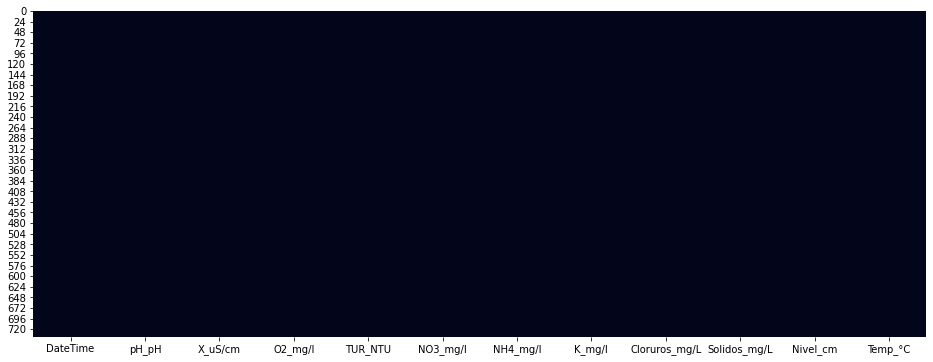

In [105]:
# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_dia.isnull(), cbar=False)

In [106]:
df_dia["Velocidad [m/s]"].value_counts(dropna=False)

KeyError: 'Velocidad [m/s]'

In [107]:
df_dia["Pluviometro [mm/min]"].value_counts(dropna=False)

KeyError: 'Pluviometro [mm/min]'

In [108]:
# Eliminamos las filas con missing Values, se elimina todos los las filas NAN son las mismas en todas las columnas 
df_dia.dropna(subset=['pH [pH]'], inplace=True)

KeyError: ['pH [pH]']

In [109]:
columnas_eliminar = ["Velocidad [m/s]", "Pluviometro [mm/min]"]
df_dia = df_dia.drop(columnas_eliminar, axis=1)

KeyError: "['Velocidad [m/s]' 'Pluviometro [mm/min]'] not found in axis"

<AxesSubplot:>

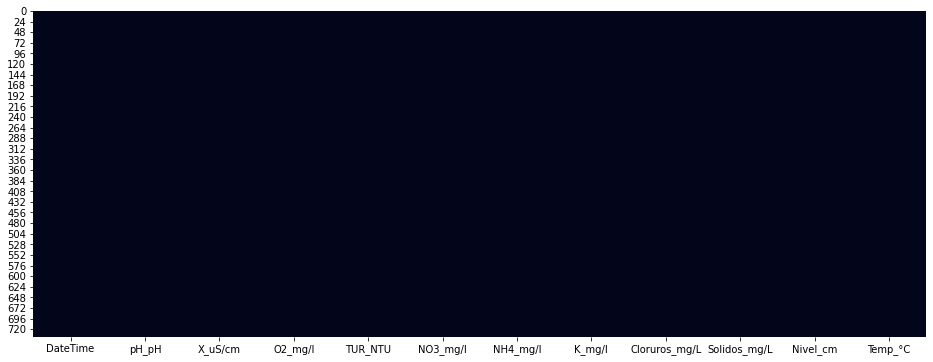

In [110]:
import seaborn as sns

# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_dia.isnull(), cbar=False)

In [111]:
df_dia.reset_index(drop=True, inplace=True)

In [112]:
columns_dia = list(df_dia.columns)
columns_dia = columns_dia[1:]

In [113]:
columns_dia

['pH_pH',
 'X_uS/cm',
 'O2_mg/l',
 'TUR_NTU',
 'NO3_mg/l',
 'NH4_mg/l',
 'K_mg/l',
 'Cloruros_mg/L',
 'Solidos_mg/L',
 'Nivel_cm',
 'Temp_°C']

In [114]:
columns_sin_espacios_dia = list()
for i in range(0,len(columns_dia)):
    columnSinEspacios = columns_dia[i].replace(" ", "")
    columnSinEspacios = columnSinEspacios.replace("[", "_")
    columnSinEspacios = columnSinEspacios.replace("]", "")
    columns_sin_espacios_dia.append(columnSinEspacios)

In [115]:
columns_sin_espacios_dia

['pH_pH',
 'X_uS/cm',
 'O2_mg/l',
 'TUR_NTU',
 'NO3_mg/l',
 'NH4_mg/l',
 'K_mg/l',
 'Cloruros_mg/L',
 'Solidos_mg/L',
 'Nivel_cm',
 'Temp_°C']

In [116]:
for i in range(len(columns_sin_espacios_dia)):
    df_dia = df_dia.rename(columns={columns_dia[i]: columns_sin_espacios_dia[i]})

In [117]:
df_dia

,DateTime,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C
0,2023-04-28 12:00:00,7.21,370.58,1.18,52.73,177.50,14.84,21.64,40.38,211.64,221.79,19.03
1,2023-04-28 12:05:00,7.19,367.68,0.90,51.57,171.44,15.01,22.76,38.99,208.63,222.69,18.76
2,2023-04-28 12:10:00,7.18,367.76,0.67,51.02,177.65,15.48,23.96,39.12,207.53,223.95,18.59
3,2023-04-28 12:15:00,7.17,368.73,0.53,50.13,177.01,15.64,24.54,37.61,206.22,227.40,18.46
4,2023-04-28 12:20:00,7.16,364.06,0.40,50.59,185.12,15.66,25.06,38.42,207.19,364.38,18.32
...,...,...,...,...,...,...,...,...,...,...,...,...
733,2023-05-01 05:40:00,7.12,359.81,0.03,55.47,134.15,18.21,41.12,55.85,214.39,420.48,16.90
734,2023-05-01 05:45:00,7.13,358.46,0.03,55.87,133.22,18.15,41.10,55.31,216.96,428.12,16.92
735,2023-05-01 05:50:00,7.13,360.80,0.03,55.81,134.26,18.10,41.22,55.75,216.18,413.43,16.92
736,2023-05-01 05:55:00,7.13,359.26,0.03,55.94,132.04,18.11,41.13,54.95,221.63,384.58,16.89


In [118]:
columns_dia = list(df_dia.columns)
columns_dia = columns_dia[1:]

In [119]:
for column in columns_dia:
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico en el primer subplot
    fig.add_trace(go.Box(y=df_dia[column], name = "Violin"), row=1, col=1)

    # Agregar el segundo gráfico en el segundo subplot
    fig.add_trace(go.Histogram(x=df_dia[column], nbinsx=100, name = "Histograma"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=950, height=400, title="Graficas de violin de "+ column +" para bomba diafragma")

    # Mostrar la figura
    fig.show()


In [120]:
variables_z = list()
for column in columns_dia:
    variable_name = "z_" + column
    globals()[variable_name] = np.abs(stats.zscore(df_dia[column]))
    variables_z.append(variable_name)
variables_z


['z_pH_pH',
 'z_X_uS/cm',
 'z_O2_mg/l',
 'z_TUR_NTU',
 'z_NO3_mg/l',
 'z_NH4_mg/l',
 'z_K_mg/l',
 'z_Cloruros_mg/L',
 'z_Solidos_mg/L',
 'z_Nivel_cm',
 'z_Temp_°C']

In [121]:
variables_atipicos = list()
for i in range(len(columns_dia)):
    variable_name = "atp_" + columns_dia[i] + "_dia"
    globals()[variable_name] = (np.where(globals()[variables_z[i]] > 3))
    variables_atipicos.append(variable_name)
variables_atipicos


['atp_pH_pH_dia',
 'atp_X_uS/cm_dia',
 'atp_O2_mg/l_dia',
 'atp_TUR_NTU_dia',
 'atp_NO3_mg/l_dia',
 'atp_NH4_mg/l_dia',
 'atp_K_mg/l_dia',
 'atp_Cloruros_mg/L_dia',
 'atp_Solidos_mg/L_dia',
 'atp_Nivel_cm_dia',
 'atp_Temp_°C_dia']

In [124]:
atp_Nivel_cm_dia

(array([ 0,  1,  2,  3, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38],
       dtype=int64),)

In [125]:
dataframe_names_dia = list()
# Crear los DataFrames y asignarles nombres de variables
for i in range(len(columns_dia)):
    dataframe_name = f"df_sin_{variables_atipicos[i]}"
    globals()[dataframe_name] = df_dia[[columns_dia[i],"DateTime"]].drop(index = globals()[variables_atipicos[i]][0])
    dataframe_names_dia.append(dataframe_name)
dataframe_names_dia


['df_sin_atp_pH_pH_dia',
 'df_sin_atp_X_uS/cm_dia',
 'df_sin_atp_O2_mg/l_dia',
 'df_sin_atp_TUR_NTU_dia',
 'df_sin_atp_NO3_mg/l_dia',
 'df_sin_atp_NH4_mg/l_dia',
 'df_sin_atp_K_mg/l_dia',
 'df_sin_atp_Cloruros_mg/L_dia',
 'df_sin_atp_Solidos_mg/L_dia',
 'df_sin_atp_Nivel_cm_dia',
 'df_sin_atp_Temp_°C_dia']

In [127]:
for i in range(len(columns_dia)):
    globals()[dataframe_names_dia[i]].reset_index(drop=True, inplace=True)


In [128]:
#globals()[dataframe_names_dia[1]].values

# Comparacion diagrama de violin, con y sin datos atipicos

In [130]:
import plotly.io as pio
for i in range(len(columns_dia)):
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico (violin plot) en el primer subplot
    fig.add_trace(go.Violin(y=df_dia[columns_dia[i]], name="sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico (violin plot) en el segundo subplot
    fig.add_trace(go.Violin(y=globals()[dataframe_names_dia[i]].iloc[:, 0], name="con limpieza"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=1000, height=400, title="Gráficas de violín de " + columns_dia[i] + " para bomba diafragma")

    # Mostrar la figura
    fig.show()
    

# Serie de tiempo para PH

In [131]:
for i in range(len(columns_dia)):
    # Crear la figura con subplots
    fig = make_subplots(rows=2, cols=1)

    # Agregar el primer gráfico de líneas en el primer subplot
    fig.add_trace(go.Line(x=df_dia['DateTime'], y=df_dia[columns_dia[i]], name = "Sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico de líneas en el segundo subplot
    fig.add_trace(go.Line(x=globals()[dataframe_names_dia[i]].iloc[:, 1], y=globals()[dataframe_names_dia[i]].iloc[:, 0], name = "Con limpieza"), row=2, col=1)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(height=500, width=1000, title_text="Gráficas de violín de " + columns_dia[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    

C:\Users\57314\anaconda3\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




# Modelos de Machine Learning 


Se puede utilizar una serie de tiempo para hacer predicciones de los valores futuros. El análisis de series de tiempo se enfoca en comprender y modelar la estructura temporal de los datos para poder hacer pronósticos.

Hay diferentes métodos y técnicas para realizar predicciones en series de tiempo. Algunas de las técnicas comunes incluyen:

Modelos de promedio móvil (MA): Estos modelos utilizan el promedio de observaciones pasadas para predecir valores futuros. Los modelos MA son útiles para datos que no muestran una tendencia o patrón claro.

Modelos autorregresivos (AR): Estos modelos se basan en regresiones lineales de los valores pasados para predecir los valores futuros. Los modelos AR son útiles para datos que muestran una tendencia o patrón autocorrelacionado.

Modelos ARIMA: Este es un modelo más complejo que combina componentes de los modelos MA y AR para modelar tanto la tendencia como la autocorrelación en los datos.

Modelos de suavizado exponencial: Estos modelos utilizan un promedio ponderado de los valores pasados para predecir los valores futuros. Son útiles cuando hay una tendencia y/o estacionalidad en los datos.

Redes neuronales recurrentes (RNN): Estos modelos son adecuados para capturar patrones complejos en los datos de series de tiempo. Las RNN, como las LSTM (Long Short-Term Memory), son populares para el pronóstico de series de tiempo.

La elección del método de predicción dependerá del tipo de datos, la presencia de tendencias, estacionalidad y otros factores. También es importante realizar una evaluación adecuada del modelo utilizando técnicas de validación y prueba.

En resumen, sí es posible utilizar una serie de tiempo para hacer predicciones de los valores futuros. Sin embargo, la elección del método y la precisión de las predicciones dependerán de la naturaleza de los datos y de la técnica utilizada.

# MODELO DE RNN PH

In [51]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense

In [142]:
X = globals()[dataframe_names[0]].iloc[:,1]
y = globals()[dataframe_names[0]].iloc[:,0]

In [143]:
globals()[dataframe_names[0]].iloc[:,0]

0       7.18
1       7.18
2       7.18
3       7.18
4       7.18
        ... 
6581    7.13
6582    7.13
6583    7.13
6584    7.14
6585    7.14
Name: pH_pH, Length: 6586, dtype: float64

In [144]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train

110    2023-04-01 09:20:00
2576   2023-04-13 01:30:00
2746   2023-04-13 16:40:00
1446   2023-04-08 10:35:00
1867   2023-04-09 22:45:00
               ...        
3772   2023-04-17 10:25:00
5191   2023-04-22 17:35:00
5226   2023-04-22 20:30:00
5390   2023-04-23 11:10:00
860    2023-04-06 07:40:00
Name: DateTime, Length: 5268, dtype: datetime64[ns]

In [145]:
# Reshape de los datos a una matriz 2D
X_train_reshaped = X_train.values.reshape(-1, 1)
X_test_reshaped = X_test.values.reshape(-1, 1)
X_train_reshaped

array([['2023-04-01T09:20:00.000000000'],
       ['2023-04-13T01:30:00.000000000'],
       ['2023-04-13T16:40:00.000000000'],
       ...,
       ['2023-04-22T20:30:00.000000000'],
       ['2023-04-23T11:10:00.000000000'],
       ['2023-04-06T07:40:00.000000000']], dtype='datetime64[ns]')

In [146]:
# Escalar los datos utilizando MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_reshaped)
X_test_scaled = scaler.transform(X_test_reshaped)
X_train_scaled

array([[0.01440514],
       [0.44681672],
       [0.47022508],
       ...,
       [0.80951768],
       [0.83215434],
       [0.1970418 ]])

In [147]:
# Crear el modelo de RNN
model = Sequential()
model.add(LSTM(100, activation='tanh', input_shape=(1, X_train_scaled.shape[1])))
model.add(Dense(3))

In [148]:
model.compile(loss='mean_squared_error', optimizer='adam')

In [149]:
model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=1)

Epoch 1/30
165/165 [==============================] - 3s 3ms/step - loss: 40.5641
Epoch 2/30
165/165 [==============================] - 1s 3ms/step - loss: 5.7054
Epoch 3/30
165/165 [==============================] - 0s 3ms/step - loss: 1.6171
Epoch 4/30
165/165 [==============================] - 1s 3ms/step - loss: 1.0513
Epoch 5/30
165/165 [==============================] - 0s 3ms/step - loss: 0.6167
Epoch 6/30
165/165 [==============================] - 0s 3ms/step - loss: 0.3215
Epoch 7/30
165/165 [==============================] - 1s 3ms/step - loss: 0.1495
Epoch 8/30
165/165 [==============================] - 0s 3ms/step - loss: 0.0655
Epoch 9/30
165/165 [==============================] - 0s 3ms/step - loss: 0.0322
Epoch 10/30
165/165 [==============================] - 1s 3ms/step - loss: 0.0216
Epoch 11/30
165/165 [==============================] - 0s 3ms/step - loss: 0.0189
Epoch 12/30
165/165 [==============================] - 0s 3ms/step - loss: 0.0184
Epoch 13/30
165/165 [===

In [150]:
loss = model.evaluate(X_test_scaled, y_test)
print("Pérdida en los datos de prueba:", loss)

42/42 [==============================] - 1s 2ms/step - loss: 0.0162
Pérdida en los datos de prueba: 0.016236497089266777


# GRAFICA original y prediccion bomba peristaltica

In [158]:
df_combinado = globals()[dataframe_names[0]][["DateTime", "pH_pH"]]


In [159]:
df_combinado

,DateTime,pH_pH
0,2023-04-01 00:00:00,7.18
1,2023-04-01 00:05:00,7.18
2,2023-04-01 00:10:00,7.18
3,2023-04-01 00:15:00,7.18
4,2023-04-01 00:20:00,7.18
...,...,...
6581,2023-04-27 23:35:00,7.13
6582,2023-04-27 23:40:00,7.13
6583,2023-04-27 23:45:00,7.13
6584,2023-04-27 23:50:00,7.14


In [176]:
df_combinado2 = pd.DataFrame()
df_combinado2["DateTime"] = globals()[datazframe_names_dia[0]].iloc[:, 1]

In [177]:
globals()[dataframe_names_dia[0]].iloc[:, 1]

0     2023-04-28 12:05:00
1     2023-04-28 12:10:00
2     2023-04-28 12:15:00
3     2023-04-28 12:20:00
4     2023-04-28 12:25:00
              ...        
732   2023-05-01 05:40:00
733   2023-05-01 05:45:00
734   2023-05-01 05:50:00
735   2023-05-01 05:55:00
736   2023-05-01 06:00:00
Name: DateTime, Length: 737, dtype: datetime64[ns]

In [178]:
X = df_combinado2['DateTime']
X = X.values.reshape(-1, 1)
X_scaled = scaler.fit_transform(X)

In [179]:
predictions = model.predict(X_scaled)

24/24 [==============================] - 0s 2ms/step


In [180]:
predictions

array([[7.210804 , 7.208987 , 7.2090607],
       [7.210985 , 7.209184 , 7.2092557],
       [7.2111664, 7.2093797, 7.2094483],
       ...,
       [7.248624 , 7.247708 , 7.2474775],
       [7.248617 , 7.2476954, 7.247461 ],
       [7.2486095, 7.247681 , 7.2474422]], dtype=float32)

In [181]:
df_combinado2["pH_pH"] = None
df_combinado2["pH_pH"] = predictions

In [182]:
df_combinado2

,DateTime,pH_pH
0,2023-04-28 12:05:00,7.210804
1,2023-04-28 12:10:00,7.210985
2,2023-04-28 12:15:00,7.211166
3,2023-04-28 12:20:00,7.211347
4,2023-04-28 12:25:00,7.211526
...,...,...
732,2023-05-01 05:40:00,7.248637
733,2023-05-01 05:45:00,7.248631
734,2023-05-01 05:50:00,7.248624
735,2023-05-01 05:55:00,7.248617


In [183]:
df_concatenado = pd.concat([df_combinado, df_combinado2])

In [184]:
df_concatenado.reset_index(drop=True, inplace=True)

In [186]:
# Con model = model
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH_pH'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)


In [187]:
# Calcular las medias móviles utilizando pandas
window_sizes = [100, 200]  # Tamaños de las ventanas de las medias móviles

for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    df_concatenado[column_name] = df_concatenado['pH_pH'].rolling(window=window_size).mean()

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH_pH'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)

# Agregar las líneas de las medias móviles
for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado[column_name], name=f'Media Móvil {window_size}'))

# Actualizar las propiedades de diseño del gráfico
fig.update_layout(title='Gráfico de Línea con Medias Móviles', xaxis_title='Fecha y Hora', yaxis_title='pH_pH')

# Mostrar el gráfico
fig.show()

# Entrenar varios modelos y elegir el mejor

In [188]:
# Lista de parámetros a probar
parametros = [
    {'lstm_units': 50, 'activation': 'tanh'},
    {'lstm_units': 50, 'activation': 'relu'},
    {'lstm_units': 50, 'activation': 'sigmoid'},
    {'lstm_units': 100, 'activation': 'tanh'},
    {'lstm_units': 100, 'activation': 'relu'},
    {'lstm_units': 100, 'activation': 'sigmoid'},
    {'lstm_units': 200, 'activation': 'tanh'},
    {'lstm_units': 200, 'activation': 'relu'},
    {'lstm_units': 200, 'activation': 'sigmoid'}
]
# Variables para almacenar el mejor modelo y su rendimiento
best_model = None
best_loss = float('inf')

In [189]:
# Bucle para entrenar y evaluar los modelos con diferentes parámetros
for params in parametros:
    # Crear el modelo de RNN
    model = Sequential()
    model.add(LSTM(params['lstm_units'], activation=params['activation'], input_shape=(1, X_train_scaled.shape[1])))
    model.add(Dense(3))

    # Compilar el modelo
    model.compile(loss='mean_squared_error', optimizer='adam')

    # Entrenar el modelo
    model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=1)
    
    # Evaluar el modelo en los datos de prueba
    loss = model.evaluate(X_test_scaled, y_test)

    # Comparar la pérdida actual con la mejor pérdida
    if loss < best_loss:
        best_loss = loss
        best_model = model
        

Epoch 1/30
165/165 [==============================] - 3s 3ms/step - loss: 44.8751
Epoch 2/30
165/165 [==============================] - 0s 2ms/step - loss: 14.0689
Epoch 3/30
165/165 [==============================] - 0s 3ms/step - loss: 2.0822
Epoch 4/30
165/165 [==============================] - 0s 2ms/step - loss: 1.4501
Epoch 5/30
165/165 [==============================] - 0s 2ms/step - loss: 1.0773
Epoch 6/30
165/165 [==============================] - 0s 2ms/step - loss: 0.7613
Epoch 7/30
165/165 [==============================] - 0s 2ms/step - loss: 0.5092
Epoch 8/30
165/165 [==============================] - 0s 2ms/step - loss: 0.3204
Epoch 9/30
165/165 [==============================] - 0s 3ms/step - loss: 0.1894
Epoch 10/30
165/165 [==============================] - 0s 2ms/step - loss: 0.1065
Epoch 11/30
165/165 [==============================] - 0s 2ms/step - loss: 0.0592
Epoch 12/30
165/165 [==============================] - 0s 2ms/step - loss: 0.0353
Epoch 13/30
165/165 [==

165/165 [==============================] - 1s 3ms/step - loss: 0.0730
Epoch 9/30
165/165 [==============================] - 1s 3ms/step - loss: 0.0359
Epoch 10/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0230
Epoch 11/30
165/165 [==============================] - 1s 5ms/step - loss: 0.0194
Epoch 12/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0186
Epoch 13/30
165/165 [==============================] - 1s 5ms/step - loss: 0.0184
Epoch 14/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0184
Epoch 15/30
165/165 [==============================] - 1s 3ms/step - loss: 0.0184
Epoch 16/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0183
Epoch 17/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0184
Epoch 18/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0183
Epoch 19/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0184
Epoch 20/30
165/165 [========

165/165 [==============================] - 1s 5ms/step - loss: 0.0184
Epoch 16/30
165/165 [==============================] - 1s 5ms/step - loss: 0.0184
Epoch 17/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0184
Epoch 18/30
165/165 [==============================] - 1s 5ms/step - loss: 0.0183
Epoch 19/30
165/165 [==============================] - 1s 5ms/step - loss: 0.0183
Epoch 20/30
165/165 [==============================] - 1s 5ms/step - loss: 0.0185
Epoch 21/30
165/165 [==============================] - 1s 5ms/step - loss: 0.0183
Epoch 22/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0184
Epoch 23/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0185
Epoch 24/30
165/165 [==============================] - 1s 7ms/step - loss: 0.0184
Epoch 25/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0184
Epoch 26/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0184
Epoch 27/30
165/165 [=======

In [190]:
print("Mejor pérdida:", best_loss)


Mejor pérdida: 0.01631877012550831


In [191]:
df_combinado = globals()[dataframe_names[0]][["DateTime", "pH_pH"]]

In [192]:
df_combinado2 = pd.DataFrame()
df_combinado2["DateTime"] = globals()[dataframe_names_dia[0]].iloc[:, 1]

In [193]:
X = df_combinado2['DateTime']
X = X.values.reshape(-1, 1)
X_scaled = scaler.fit_transform(X)

In [195]:
# Utilizar el mejor modelo para hacer predicciones
predictions = best_model.predict(X_scaled)

24/24 [==============================] - 0s 4ms/step


In [196]:
df_combinado2["pH_pH"] = None
df_combinado2["pH_pH"] = predictions

In [197]:
df_concatenado = pd.concat([df_combinado, df_combinado2])

In [199]:
df_concatenado.reset_index(drop=True, inplace=True)

In [200]:
# Con model = model
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH_pH'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)


# Calcular las medias móviles utilizando pandas
window_sizes = [100, 200]  # Tamaños de las ventanas de las medias móviles

for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    df_concatenado[column_name] = df_concatenado['pH [pH]'].rolling(window=window_size).mean()

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH [pH]'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH [pH]'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)

# Agregar las líneas de las medias móviles
for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado[column_name], name=f'Media Móvil {window_size}'))

# Actualizar las propiedades de diseño del gráfico
fig.update_layout(title='Gráfico de Línea con Medias Móviles', xaxis_title='Fecha y Hora', yaxis_title='pH [pH]')

# Mostrar el gráfico
fig.show()

# GRAFICA original y prediccion bomba peristaltica

## Parametros de oxigenio y solidos suspendidos... Que pueden tener una gran variacion 

## CODIGO ANTERIOR 

In [ ]:
df_sol_datos = df.iloc[2:,0:48]
df_sol_datos.reset_index(drop=True, inplace=True)
df_sol_datos

In [ ]:
#Pasar datos a datetime 
df_sol_datos["Fecha & Hora"] = df_sol_datos["Fecha & Hora"].apply(lambda x: datetime.strptime(x, "%d/%m/%Y %H:%M"))
print(df_sol_datos["Fecha & Hora"])

In [ ]:
df_sol_datos.dtypes

In [ ]:
null_count = df_sol_datos.isnull().sum(axis=0)
# Imprimimos el resultado
print(null_count)

In [ ]:
import seaborn as sns

# Identificamos los missing values visualmente
sns.heatmap(df_sol_datos.isnull(), cbar=False)

In [ ]:
df_sol_datos["APULO"].value_counts()

## APULO PH

In [ ]:
#Para hacer imputacion de datos, con la mediana, pasamos los textos a Nan, y luego si hacemos imputacion 
df_sol_datos["APULO"] = df_sol_datos["APULO"].replace("Sin Data", np.nan)
df_sol_datos["APULO"] = df_sol_datos["APULO"].replace("<Muestra", np.nan)
mediana = df_sol_datos["APULO"].median()
df_sol_datos["APULO"].fillna(mediana, inplace=True)

print(df_sol_datos["APULO"])

In [ ]:
#convertir los numeros a float
df_sol_datos["APULO"] = df_sol_datos["APULO"].astype(float)

In [ ]:
df_sol_datos.dtypes

In [ ]:
import plotly.express as px
fig = px.line(df_sol_datos, x='Fecha & Hora', y="APULO")
fig.show()

# Nulls

In [ ]:
null_count = df_sol_datos.isnull().sum(axis=0)
# Imprimimos el resultado
print(null_count)

In [ ]:
import seaborn as sns

# Identificamos los missing values visualmente
sns.heatmap(df_sol_datos.isnull(), cbar=False)

In [ ]:
# Eliminamos las filas con missing de Dioxido de Azufre
print("valores perdidos en Dióxido de Azufre (μg/m³) sin limpieza: " + 
      str(df['Dióxido de Azufre (μg/m³)'].isnull().sum()))


df.dropna(subset=['Dióxido de Azufre (μg/m³)'], inplace=True)


print("valores perdidos en Dióxido de Azufre (μg/m³) con limpieza: " + 
      str(df['Dióxido de Azufre (μg/m³)'].isnull().sum()))

In [ ]:
#para que el index sea continuo, y no quede con huecos de las columnas que elimine
df.reset_index(drop=True, inplace=True)
# El parámetro drop=True se utiliza para eliminar el índice existente en lugar de crear una nueva columna con él
# El parámetro inplace=True se utiliza para aplicar los cambios directamente en el DataFrame df

In [ ]:
type(df["Dioxido de Nitrogeno (μg/m³)"][2])

In [ ]:
df[(df["Dioxido de Nitrogeno (μg/m³)"]>21)].head()
#Dioxido mayor a 21

In [ ]:
#dfclean.groupby(by="city")["monthlycharges"].describe()
#group by para máximo

In [ ]:
df = df.fillna(0)

# Matriz de correlaciones

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=True)


In [ ]:
plt.figure(figsize=(16, 6))
# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(df.corr(), dtype=np.bool))
heatmap = sns.heatmap(df.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize':18}, pad=16);

In [ ]:
plt.figure(figsize=(6, 12))
heatmap = sns.heatmap(df.corr()[['Velocidad del Viento (m/s)']].sort_values(by='Velocidad del Viento (m/s)', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('correlacion de variables con velocidad del viento', fontdict={'fontsize':18}, pad=16);

# Diagrama de vigotes

In [ ]:
import seaborn as sns

In [ ]:
df.describe()

In [ ]:
columnas = df.columns.values

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[1]])    

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[2]])    

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[3]])  

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[4]])

In [ ]:
plt.figure(figsize=(15, 9))
sns.boxplot(data=df[[columnas[5], columnas[6]]], orient="h")

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[7]])

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[8]])

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[9]])

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[10]])

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[11]])

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[12]])

# Series de tiempo 

In [ ]:
df["PM10 (μg/m³)"][0:100]

In [ ]:
sec_df = df[0:4000]
sec_df.Fecha

In [ ]:
plt.figure(figsize=(20, 6))
sns.lineplot(x = 'Fecha', y = 'PM10 (μg/m³)',data = sec_df)

In [ ]:
import plotly.express as px
fig = px.line(sec_df, x='Fecha', y="PM10 (μg/m³)")
fig.show()

In [ ]:
fig = px.bar(sec_df, x="Fecha", y="PM10 (μg/m³)")
fig.show()

In [ ]:
plt.figure(figsize=(20, 6))
sns.lineplot(x = 'Fecha', y = 'Dióxido de Azufre (μg/m³)',data = sec_df)

In [ ]:
df_index_fecha = df.set_index("Fecha")

In [ ]:
df_index_fecha.loc["2023"]

# Identificar datos

In [ ]:
#https://barcelonageeks.com/detectar-y-eliminar-los-valores-atipicos-con-python/
from scipy import stats
#La puntuación Z también se denomina puntuación estándar.
z = np.abs(stats.zscore(df['Dioxido de Nitrogeno (μg/m³)']))
#Ahora, para definir un valor de umbral atípico, se elige que generalmente es 3.0. Como el 99,7% de los puntos de datos se encuentran entre +/- 3 desviaciones estándar (usando el enfoque de distribución gaussiana).

In [ ]:
z

In [ ]:
print(np.where(z > 3))

In [ ]:
atipicos_NO2 = np.where(z > 3)

In [ ]:
df_atipicos_NO2 = df.loc[100]

In [ ]:
df_atipicos_NO2['Fecha'].strftime('%H:%M').value_counts()

In [ ]:
 df.loc[atipicos_NO2]

In [ ]:
df_index_fecha.loc["2023-01-01"]

In [ ]:
df_sin_at_NO2 = df.drop(index = atipicos_NO2[0] )
df_sin_at_NO2

# Dioxido de nitrogeno sin valores atipicos

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df[columnas[1]]) 
plt.title('Boxplot de ' + columnas[1])

In [ ]:
plt.figure(figsize=(15, 6))
sns.boxplot(x=df_sin_at_NO2["Dioxido de Nitrogeno (μg/m³)"]) 
plt.title('Boxplot de ' + columnas[1])

In [ ]:
fig = px.box(y=df_sin_at_NO2["Dioxido de Nitrogeno (μg/m³)"], width=500, height=400)
fig.show()

In [ ]:
fig = px.line(df_sin_at_NO2, x='Fecha', y="Dioxido de Nitrogeno (μg/m³)")
fig.show()

In [ ]:
NO2_M_26 = df[(df["Dioxido de Nitrogeno (μg/m³)"]>26.2)]
#Dioxido mayor a 21

In [ ]:
fig = px.line(NO2_M_26, x='Fecha', y="Dioxido de Nitrogeno (μg/m³)")
fig.show()

In [ ]:
fig = px.scatter(NO2_M_26, x='Fecha', y="Dioxido de Nitrogeno (μg/m³)")
fig.show()

In [ ]:
#Codigo para HTML
import plotly.graph_objects as go
import plotly.offline as pyo

fig = go.Figure(data=go.Scatter(x=NO2_M_26['Fecha'], y=NO2_M_26['Dioxido de Nitrogeno (μg/m³)'], mode='markers'))
pyo.plot(fig, filename='grafica1.html')

# Especificar la ruta completa de la carpeta y el nombre del archivo
ruta_carpeta = '/ruta/completa/a/la/carpeta/'
nombre_archivo = 'grafica1.html'
ruta_completa = ruta_carpeta + nombre_archivo

# Guardar el gráfico en la ruta especificada
pyo.plot(fig, filename=ruta_completa)

In [ ]:
# CONTAR LOS DATOS POR MES 

In [ ]:
# Filtrar los datos por el mes y año deseado
mes = 3  # Mes: MARZO
año = 2023  # Año: 2023
datos_en_enero_2023 = NO2_M_26[(NO2_M_26['Fecha'].dt.month == mes) & (NO2_M_26['Fecha'].dt.year == año)]

# Contar cuántos datos hay en enero del 2023
cantidad_datos = len(datos_en_enero_2023)

print("Cantidad de datos en marzo del 2023, mayores a 26.2:", cantidad_datos)

In [ ]:
# Filtrar los datos por el mes y año deseado
mes = 1  # Mes: enero
año = 2023  # Año: 2023
datos_en_enero_2023 = NO2_M_26[(NO2_M_26['Fecha'].dt.month == mes) & (NO2_M_26['Fecha'].dt.year == año)]

# Contar cuántos datos hay en enero del 2023
cantidad_datos = len(datos_en_enero_2023)

print("Cantidad de datos en enero del 2023, mayores a 26.2:", cantidad_datos)

In [ ]:
# Filtrar los datos por el mes y año deseado
mes = 2  # Mes: febrero
año = 2023  # Año: 2023
datos_en_enero_2023 = NO2_M_26[(NO2_M_26['Fecha'].dt.month == mes) & (NO2_M_26['Fecha'].dt.year == año)]

# Contar cuántos datos hay en enero del 2023
cantidad_datos = len(datos_en_enero_2023)

print("Cantidad de datos en febrero del 2023, mayores a 26.2:", cantidad_datos)

In [ ]:
# Filtrar los datos por el mes y año deseado
mes = 11  # Mes: noviembre
año = 2022  # Año: 2022
datos_en_enero_2023 = NO2_M_26[(NO2_M_26['Fecha'].dt.month == mes) & (NO2_M_26['Fecha'].dt.year == año)]

# Contar cuántos datos hay en enero del 2023
cantidad_datos = len(datos_en_enero_2023)

print("Cantidad de datos en noviemrbe del ", año , " mayores a 26.2:", cantidad_datos)

In [ ]:
#Dataframe con los valores 
df_datosmayores_NO2 = pd.DataFrame(columns=['mes', 'NO2 mayores a 26.2'])
for i in range (8,13):
    mes = i 
    año = 2022
    fecha = i,2022
    datos = NO2_M_26[(NO2_M_26['Fecha'].dt.month == mes) & (NO2_M_26['Fecha'].dt.year == año)]
    cantidad_datos = len(datos)
    df_datosmayores_NO2 = df_datosmayores_NO2.append({'mes': fecha, 'NO2 mayores a 26.2': cantidad_datos}, ignore_index=True)
for i in range (1,5):
    mes = i 
    año = 2023
    fecha = i,año
    datos = NO2_M_26[(NO2_M_26['Fecha'].dt.month == mes) & (NO2_M_26['Fecha'].dt.year == año)]
    cantidad_datos = len(datos)
    df_datosmayores_NO2 = df_datosmayores_NO2.append({'mes': fecha, 'NO2 mayores a 26.2': cantidad_datos}, ignore_index=True)



In [ ]:
df_datosmayores_NO2